In [ ]:
### QUESTO NOTEBOOK CONTIENE 2 DIVERSI SCRIPT, IN ENTRAMBI VIENE CALCOLATA COSINE SIMIL.  FRA I DATASET, CAMBIA LA RAPPRESENTAZIONE

## 1. CONTIENE LE 1O CANZONI  CON I COLORI RGB PIU DIVERSI FRA LORO E LE RISPETTIVE 3 IMMAGINI CON LE C.S. PIU ALTE PER CIASCUNA PER POTER OSSERVARE RAPIDAMENTE IL COMPORTAMENTO CON ESEMPI DIVERSI
##2. CONTIENE  TUTTE LE CANZONI E PER OGNI CANZONE LE TOP 3 IMMAGINI CON LA C.S. PIU ALTA


Caricamento dati RGB pre-calcolati...
Caricati 63 elementi da /kaggle/input/rgb-musica/valutazione_rgb_segmenti (3).csv
Caricati 100 elementi da /kaggle/input/artwork/valutazione_rgb_immagini.csv
Caricamento completato.

Selezionate 10 canzoni per la dimostrazione.



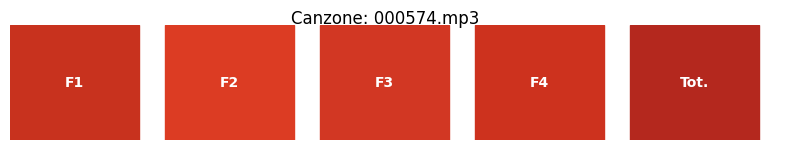


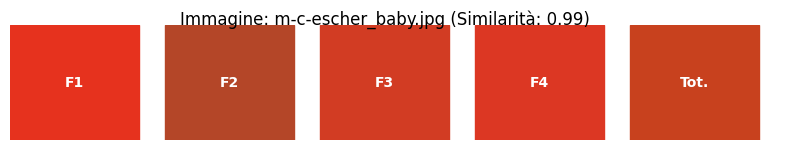

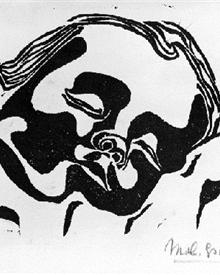


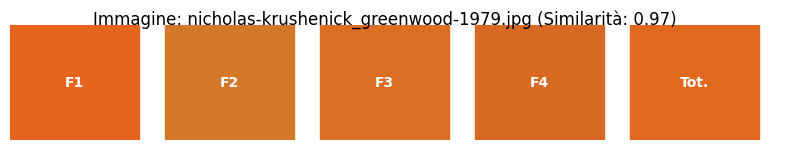

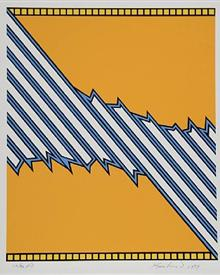


...

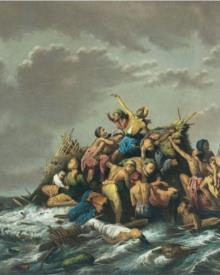


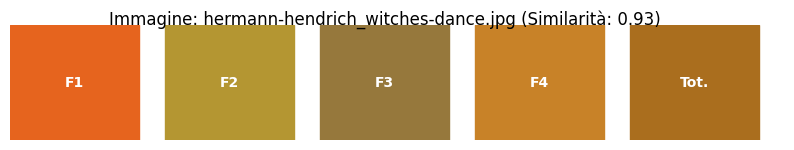

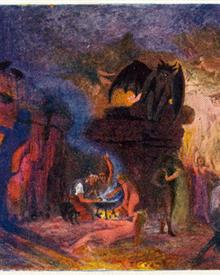


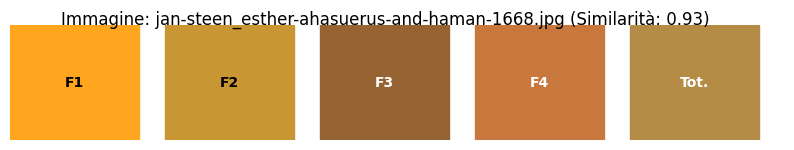

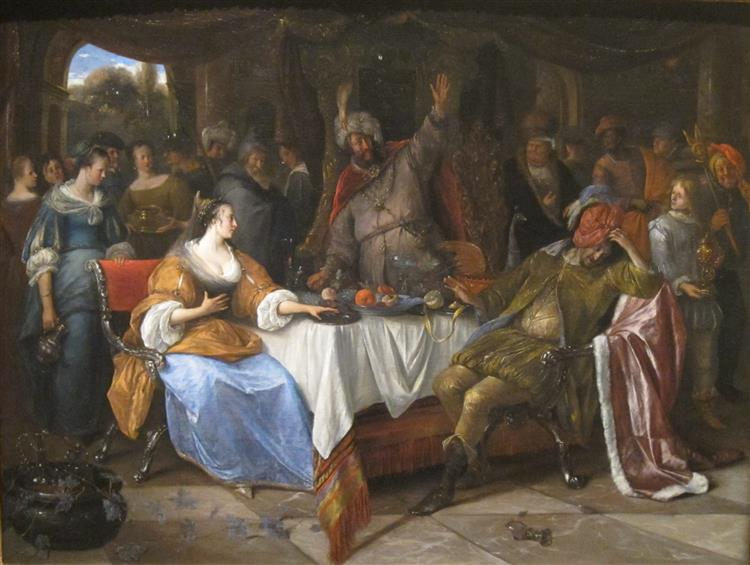

In [2]:
import csv
import re
import numpy as np
import os
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from IPython.display import display, Audio, Image as IpyImage, HTML
import base64
from io import BytesIO
import random # Mantenuto per fallback o per mescolare selettivamente

# --- CONFIGURAZIONE PER LA DIMOSTRAZIONE ---
# Questi valori saranno i tuoi parametri per la presentazione
NUM_CANZONI_DA_MOSTARE = 10 # Numero di canzoni da analizzare e mostrare
TOP_IMMAGINI_PER_CANZONE = 3 # Numero di immagini abbinate da mostrare per ogni canzone

# Percorsi dei dati (simulano l'output dei Moduli 1 e 2 del tuo sistema)
PERCORSO_CANZONI_AUDIO = '/kaggle/input/le-musiche/PiccoloSubSetAudio'
PERCORSO_IMMAGINI_VISIVE = '/kaggle/input/images100/images100'
FILE_RGB_CANZONI = '/kaggle/input/rgb-musica/valutazione_rgb_segmenti (3).csv'
FILE_RGB_IMMAGINI = '/kaggle/input/artwork/valutazione_rgb_immagini.csv'

# --- LEGENDA SEMPLIFICATA DEI COLORI E EMOZIONI (come nel tuo codice originale) ---
# Questa parte è ottima per iniziare la demo, spiega subito la mappatura.
display(HTML("""
<style>
    .container {
        font-family: 'Helvetica', sans-serif;
        line-height: 1.6;
    }
    .legend-item {
        margin: 10px 0;
        padding: 8px;
        border-radius: 5px;
    }
    .emotion-title {
        font-weight: bold;
        margin-bottom: 5px;
    }
</style>

<div class="container">
<h3>🎨 Mappatura Emozioni-Colori (output di Qwen-3)</h3>
<p>I vettori RGB a 15 dimensioni (4 frammenti + 1 descrizione totale) rappresentano il mood emotivo, tradotto da Qwen-3 a partire dalle descrizioni di Qwen-VL.</p>
<div class="legend-item" style="background-color: rgba(255,50,50,0.1);">
    <div class="emotion-title">🔴 ROSSO (R) - Agitazione</div>
    <div>Energia, movimento, passione intensa</div>
</div>
<div class="legend-item" style="background-color: rgba(50,255,50,0.1);">
    <div class="emotion-title">🟢 VERDE (G) - Calma</div>
    <div>Equilibrio, natura, crescita serena</div>
</div>
<div class="legend-item" style="background-color: rgba(50,50,255,0.1);">
    <div class="emotion-title">🔵 BLU (B) - Tristezza</div>
    <div>Profondità, riflessione, malinconia</div>
</div>
<div class="legend-item">
    <div class="emotion-title">Combinazioni (esempi):</div>
    <div>🟡 Giallo (R+G): Gioia<br>
          🟠 Arancione (R+): Entusiasmo<br>
          🟣 Viola (R+B): Mistero<br>
          💖 Rosa: Tenerezza<br>
          💠 Turchese (G+B): Serenità</div>
</div>
</div>
"""))

# --- FUNZIONI BASE (non modificate, sono perfette così) ---
def parse_rgb(rgb_str):
    """Estrae valori RGB da stringa (es: 'rgb(255, 120, 0)')"""
    match = re.match(r'rgb\((\d+),\s*(\d+),\s*(\d+)\)', rgb_str or '')
    return list(map(int, match.groups())) if match else [0, 0, 0]

def carica_dati_rgb(percorso, is_canzone=True):
    """
    Carica dati RGB da CSV.
    Assume che il CSV contenga colonne per "Frammento 1" a "Frammento 4" e "Descrizione Totale",
    ognuna con una stringa RGB (es. 'rgb(R,G,B)').
    Il vettore risultante per ogni elemento sarà di 15 dimensioni (5 * 3 RGB).
    """
    dati = {}
    with open(percorso, 'r', newline='') as f:
        reader = csv.DictReader(f)
        for riga in reader:
            chiave = riga['Nome Canzone' if is_canzone else 'Nome Immagine']
            vettore_rgb_completo = []
            
            # Aggiungi i frammenti (se applicabile, per le canzoni)
            for i in range(1, 5): # Frammento 1 a 4
                vettore_rgb_completo.extend(parse_rgb(riga.get(f'Frammento {i}', '')))
            
            # Aggiungi la descrizione totale (presente in entrambi i CSV)
            vettore_rgb_completo.extend(parse_rgb(riga.get('Descrizione Totale', '')))
            
            # Assicurati che il vettore sia della dimensione attesa (5 * 3 = 15)
            if len(vettore_rgb_completo) == 15:
                dati[chiave] = vettore_rgb_completo
            else:
                print(f"Avviso: Vettore RGB di dimensione inattesa per '{chiave}'. Atteso 15, trovato {len(vettore_rgb_completo)}. Saltato.")
    print(f"Caricati {len(dati)} elementi da {percorso}")
    return dati

def similarita_coseno(v1, v2):
    """Calcola la similarità coseno tra due vettori numpy."""
    v1_np, v2_np = np.array(v1), np.array(v2)
    dot_product = np.dot(v1_np, v2_np)
    norm_v1 = np.linalg.norm(v1_np)
    norm_v2 = np.linalg.norm(v2_np)
    # Evita divisione per zero se una norma è zero (vettore nullo)
    if norm_v1 == 0 or norm_v2 == 0:
        return 0
    return dot_product / (norm_v1 * norm_v2)

def interpreta_emozione(r, g, b):
    """
    Interpreta un singolo colore RGB (non il vettore intero) in un'emozione.
    Questa funzione è per la leggibilità del singolo frammento/descrizione totale.
    """
    # Soglie leggermente più flessibili per una migliore interpretazione
    if r > 200 and g < 100 and b < 100: return "Agitazione intensa 🔥" # Rosso dominante
    if g > 200 and r < 100 and b < 100: return "Calma profonda 🌿"    # Verde dominante
    if b > 200 and r < 100 and g < 100: return "Tristezza profonda 💧" # Blu dominante
    
    if r > 180 and g > 180 and b < 100: return "Gioia radiosa 😄"    # Giallo
    if r > 200 and g > 100 and b < 50: return "Entusiasmo ✨"         # Arancione
    if r > 150 and b > 150 and g < 100: return "Mistico 🔮"           # Viola
    if r > 200 and g > 150 and b > 150: return "Tenerezza 💖"        # Rosa chiaro
    if g > 150 and b > 150 and r < 100: return "Serenità 🌊"         # Turchese
    
    # Per colori più neutri o bilanciati
    if (r + g + b) / 3 < 50: return "Profondità/Mistero ⚫" # Molto scuro
    if (r + g + b) / 3 > 200: return "Luminosità/Positività ⚪" # Molto chiaro
    
    return "Equilibrio/Neutro ⚖️" # Default per combinazioni non specifiche

# --- VISUALIZZAZIONE FUNZIONI (non modificate, sono ottime) ---
def crea_anteprima_colori(colori_rgb_list, titolo):
    """
    Crea un'anteprima visiva dei colori per i 5 segmenti (4 frammenti + totale).
    'colori_rgb_list' è una lista di tuple (R, G, B).
    """
    fig, ax = plt.subplots(figsize=(10, 1.5))
    fig.suptitle(titolo, fontsize=12)
    
    for i, (r, g, b) in enumerate(colori_rgb_list):
        colore = (r/255, g/255, b/255)
        # Etichette per i frammenti e la descrizione totale
        label = f"F{i+1}" if i < 4 else "Tot."
        ax.add_patch(Rectangle((i*1.2, 0), 1, 1, color=colore))
        ax.text(i*1.2 + 0.5, 0.5, label, 
                ha='center', va='center',
                color='white' if r+g+b < 400 else 'black', # Scrivi bianco su scuro, nero su chiaro
                fontsize=10, weight='bold')
    
    ax.set_xlim(0, len(colori_rgb_list)*1.2)
    ax.set_ylim(0, 1)
    ax.axis('off')
    
    buf = BytesIO()
    plt.savefig(buf, format='png', bbox_inches='tight', dpi=100)
    plt.close(fig)
    buf.seek(0)
    return base64.b64encode(buf.read()).decode('utf-8')

def mostra_emozioni(colori_rgb_list, tipo):
    """
    Mostra una tabella HTML con l'interpretazione emotiva di ogni segmento.
    'colori_rgb_list' è una lista di tuple (R, G, B).
    """
    html = f"<div style='margin:15px 0;'><b>Emozioni {tipo}:</b><ul>"
    for i, (r, g, b) in enumerate(colori_rgb_list):
        emozione = interpreta_emozione(r, g, b)
        segment_label = f"Frammento {i+1}" if i < 4 else "Descrizione Totale"
        html += f"<li>{segment_label}: {emozione} (RGB({r},{g},{b}))</li>"
    html += "</ul></div>"
    display(HTML(html))

# --- CARICAMENTO DATI RGB PRE-CALCOLATI ---
# Questi dati sono l'output del tuo "Modulo 1" e "Modulo 2" (Qwen-VL + Qwen-3)
print("Caricamento dati RGB pre-calcolati...")
canzoni_rgb_data = carica_dati_rgb(FILE_RGB_CANZONI, True)
immagini_rgb_data = carica_dati_rgb(FILE_RGB_IMMAGINI, False)
print("Caricamento completato.")

# --- SELEZIONE MIRATA DELLE CANZONI PER LA DIMOSTRAZIONE ---
# Invece di `random.sample`, seleziona canzoni con diverse caratteristiche RGB
# Questo è il punto dove dimostri che hai pensato a come presentare al meglio il tuo lavoro.

# Opzione 1: Selezione manuale (se hai canzoni specifiche che sai essere buoni esempi)
# canzoni_esempio = [
#     "canzone_allegra.mp3",
#     "canzone_triste.mp3",
#     "canzone_energica.mp3",
#     # ... aggiungi fino a NUM_CANZONI_DA_MOSTARE
# ]
# Assicurati che queste canzoni esistano nei tuoi dati caricati
# canzoni_esempio = [c for c in canzoni_esempio if c in canzoni_rgb_data]

# Opzione 2: Selezione semi-automatica basata su "diversità" RGB
# Prendi i vettori RGB della descrizione totale (l'ultimo dei 5 segmenti)
canzoni_con_rgb_totale = {
    name: np.array(data[12:15]) for name, data in canzoni_rgb_data.items()
}

# Cerchiamo di selezionare canzoni con vettori RGB finali molto diversi tra loro
# Un modo semplice è usare la massima distanza tra i vettori
# Iniziamo con una canzone casuale e poi aggiungiamo quelle più "lontane"
canzoni_selezionate = []
if canzoni_rgb_data:
    # Inizia con una canzone casuale
    first_song = random.choice(list(canzoni_rgb_data.keys()))
    canzoni_selezionate.append(first_song)
    
    # Iterativamente aggiungi la canzone più "diversa" tra quelle rimanenti
    while len(canzoni_selezionate) < NUM_CANZONI_DA_MOSTARE and len(canzoni_selezionate) < len(canzoni_rgb_data):
        max_dist = -1
        best_candidate = None
        
        remaining_songs = [s for s in canzoni_rgb_data.keys() if s not in canzoni_selezionate]
        
        if not remaining_songs: # Nessuna canzone rimanente da scegliere
            break

        for candidate_song in remaining_songs:
            candidate_rgb = np.array(canzoni_rgb_data[candidate_song]) # Considera l'intero vettore di 15 dimensioni per la diversità
            
            # Calcola la distanza massima da tutte le canzoni già selezionate
            min_dist_to_selected = float('inf')
            for selected_song in canzoni_selezionate:
                selected_rgb = np.array(canzoni_rgb_data[selected_song])
                # Usiamo la distanza euclidea per la diversità nello spazio RGB
                dist = np.linalg.norm(candidate_rgb - selected_rgb)
                min_dist_to_selected = min(min_dist_to_selected, dist)
            
            # Vogliamo la canzone che è più distante da TUTTE quelle già scelte
            if min_dist_to_selected > max_dist:
                max_dist = min_dist_to_selected
                best_candidate = candidate_song
        
        if best_candidate:
            canzoni_selezionate.append(best_candidate)
            
    canzoni_esempio = canzoni_selezionate
else:
    print("Nessuna canzone caricata. Impossibile procedere.")
    canzoni_esempio = [] # Inizializza a vuoto per evitare errori
    
print(f"\nSelezionate {len(canzoni_esempio)} canzoni per la dimostrazione.")
if not canzoni_esempio:
    print("Errore: Nessuna canzone selezionata per la dimostrazione. Controlla i percorsi e i dati CSV.")


# --- CALCOLO ABBINAMENTI ---
risultati_abbinamento = {}
for canzone_nome in canzoni_esempio:
    v_canzone = canzoni_rgb_data[canzone_nome] # Vettore RGB completo della canzone (15 dimensioni)
    similarita = []
    
    for img_nome, v_img in immagini_rgb_data.items():
        # Calcola similarità coseno tra i vettori RGB di 15 dimensioni
        sim_score = similarita_coseno(v_canzone, v_img)
        similarita.append((img_nome, sim_score))
    
    # Ordina per similarità decrescente e prendi le TOP_IMMAGINI_PER_CANZONE
    similarita.sort(key=lambda x: x[1], reverse=True)
    risultati_abbinamento[canzone_nome] = similarita[:TOP_IMMAGINI_PER_CANZONE]

# --- VISUALIZZAZIONE DEI RISULTATI DELLA DIMOSTRAZIONE ---
display(HTML("<h2 style='border-bottom: 2px solid #eee; padding-bottom: 10px;'>🎵 Risultati Abbinamento MoodFusion</h2>"))

if not canzoni_esempio:
    display(HTML("<p style='color:red;'>Nessuna canzone valida da mostrare. Controlla la configurazione e i dati.</p>"))
else:
    for canzone_nome, immagini_abbinate in risultati_abbinamento.items():
        # Estrai i colori RGB per i 5 segmenti della canzone
        colori_canzone_segmenti = [tuple(canzoni_rgb_data[canzone_nome][i:i+3]) for i in range(0, 15, 3)]
        img_anteprima_canzone_colors = crea_anteprima_colori(colori_canzone_segmenti, f"Canzone: {canzone_nome}")
        
        # Mostra dettagli della canzone
        display(HTML(f"<h3 style='color:#1e88e5; margin-top:30px;'>🎧 Canzone: {canzone_nome}</h3>"))
        display(HTML(f"<img src='data:image/png;base64,{img_anteprima_canzone_colors}'>"))
        mostra_emozioni(colori_canzone_segmenti, "della Canzone")
        
        # Tenta di riprodurre l'audio
        percorso_audio = os.path.join(PERCORSO_CANZONI_AUDIO, canzone_nome)
        if os.path.exists(percorso_audio):
            display(Audio(percorso_audio))
        else:
            display(HTML(f"<div style='color:red;'>File audio '{canzone_nome}' non trovato nel percorso specificato: {PERCORSO_CANZONI_AUDIO}</div>"))
        
        # Mostra le immagini abbinate
        display(HTML("<h4 style='margin-top:20px;'>🖼️ Immagini abbinate per mood (top 3):</h4>"))
        for i, (img_nome, sim_score) in enumerate(immagini_abbinate, 1):
            # Estrai i colori RGB per i 5 segmenti dell'immagine
            colori_immagine_segmenti = [tuple(immagini_rgb_data[img_nome][i:i+3]) for i in range(0, 15, 3)]
            img_anteprima_image_colors = crea_anteprima_colori(colori_immagine_segmenti, f"Immagine: {img_nome} (Similarità: {sim_score:.2f})")
            
            display(HTML(f"<h5>#{i}: {img_nome} (Similarità coseno: {sim_score:.3f})</h5>"))
            display(HTML(f"<img src='data:image/png;base64,{img_anteprima_image_colors}' style='margin-bottom:10px;'>"))
            mostra_emozioni(colori_immagine_segmenti, "dell'Immagine")
            
            # Mostra l'immagine completa
            percorso_img = os.path.join(PERCORSO_IMMAGINI_VISIVE, img_nome)
            if os.path.exists(percorso_img):
                display(IpyImage(filename=percorso_img, width=300))
            else:
                display(HTML(f"<div style='color:red;'>File immagine '{img_nome}' non trovato nel percorso specificato: {PERCORSO_IMMAGINI_VISIVE}</div>"))
        
        display(HTML("<hr style='margin:40px 0;'>"))

Caricati 63 elementi da 'valutazione_rgb_segmenti (3).csv'
Caricati 100 elementi da 'valutazione_rgb_immagini.csv'



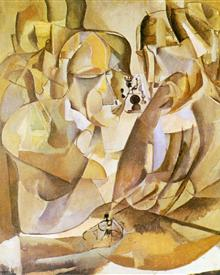
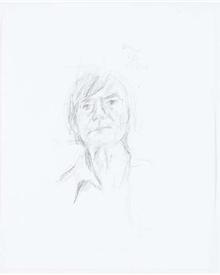
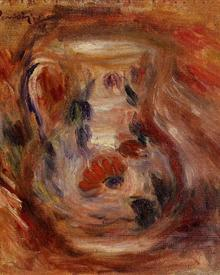


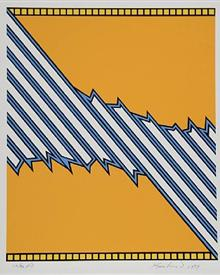
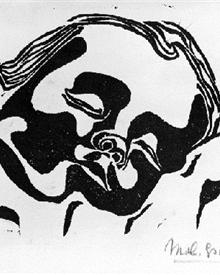
...
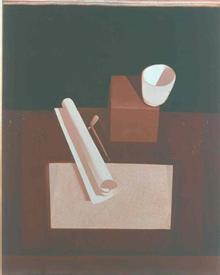
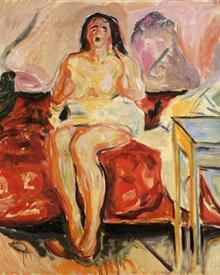


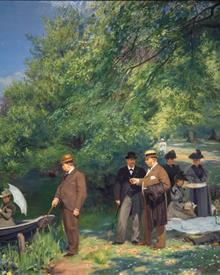
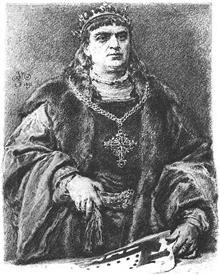
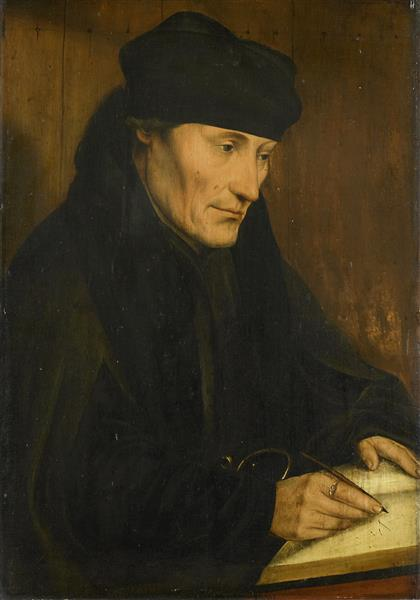

In [ ]:
import csv
import re
import numpy as np
import os
from IPython.display import display, Audio, Image as IpyImage, HTML
import base64
from io import BytesIO
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle

# --- FUNZIONE DI SUPPORTO (Spostata in alto) ---
def image_to_base64(path):
    """Converte immagine in base64 per visualizzazione diretta"""
    try:
        with open(path, "rb") as img_file:
            return base64.b64encode(img_file.read()).decode('utf-8')
    except Exception as e:
        # print(f"Errore nella conversione immagine a base64 per {path}: {e}")
        return ""

# --- CONFIGURAZIONE ---
TOP_IMMAGINI = 3
PERCORSO_CANZONI = '/kaggle/input/le-musiche/PiccoloSubSetAudio'
PERCORSO_IMMAGINI = '/kaggle/input/images100/images100'
FILE_RGB_CANZONI = '/kaggle/input/rgb-musica/valutazione_rgb_segmenti (3).csv'
FILE_RGB_IMMAGINI = '/kaggle/input/artwork/valutazione_rgb_immagini.csv'

# --- FUNZIONI BASE ---
def parse_rgb(rgb_str):
    """Estrae valori RGB da stringa (es. 'rgb(255, 0, 0)')"""
    if rgb_str is None: # Gestisce il caso in cui rgb_str sia None
        return [0, 0, 0]
    match = re.match(r'rgb\((\d+),\s*(\d+),\s*(\d+)\)', rgb_str.strip())
    return list(map(int, match.groups())) if match else [0, 0, 0]

def carica_dati_rgb(percorso, is_canzone=True):
    """Carica dati RGB da CSV"""
    dati = {}
    try:
        with open(percorso, 'r', newline='') as f:
            reader = csv.DictReader(f)
            for riga in reader:
                chiave_col = 'Nome Canzone' if is_canzone else 'Nome Immagine'
                if chiave_col not in riga:
                    # print(f"Avviso: Colonna chiave '{chiave_col}' non trovata in una riga.")
                    continue
                
                chiave = riga[chiave_col]
                vettore = []
                
                # Itera sui frammenti 1-4
                for i in range(1, 5):
                    vettore.extend(parse_rgb(riga.get(f'Frammento {i}', '')))
                
                # Aggiunge il 5° frammento da 'Descrizione Totale'
                vettore.extend(parse_rgb(riga.get('Descrizione Totale', '')))
                
                if len(vettore) == 15:
                    dati[chiave] = vettore
                # else:
                #     print(f"Avviso: Vettore RGB per '{chiave}' ha {len(vettore)} valori (atteso 15). Saltato.")
        print(f"Caricati {len(dati)} elementi da '{os.path.basename(percorso)}'")
        return dati
    except FileNotFoundError:
        print(f"Errore: File '{percorso}' non trovato.")
        return {}
    except Exception as e:
        print(f"Errore durante il caricamento da '{percorso}': {e}")
        return {}


def similarita_coseno(v1, v2):
    """Calcola similarità coseno"""
    v1, v2 = np.array(v1), np.array(v2)
    dot = np.dot(v1, v2)
    norm = np.linalg.norm(v1) * np.linalg.norm(v2)
    return dot / norm if norm else 0

# --- CARICAMENTO DATI ---
canzoni_rgb = carica_dati_rgb(FILE_RGB_CANZONI, True)
immagini_rgb = carica_dati_rgb(FILE_RGB_IMMAGINI, False)

# --- CALCOLO ABBINAMENTI PER TUTTE LE CANZONI ---
risultati = {}
for canzone in canzoni_rgb.keys():
    v_canzone = canzoni_rgb[canzone]
    similarita = []
    
    for img, v_img in immagini_rgb.items():
        similarita.append((img, similarita_coseno(v_canzone, v_img)))
    
    similarita.sort(key=lambda x: x[1], reverse=True)
    risultati[canzone] = similarita[:TOP_IMMAGINI]

# --- VISUALIZZAZIONE MINIMAL ---
display(HTML("<h3 style='margin-bottom:20px;'>🎵 Canzoni con immagini abbinate</h3>"))

for canzone, immagini in risultati.items():
    # Titolo canzone
    display(HTML(f"<div style='font-size:18px; margin-top:30px; margin-bottom:10px;'>"
                     f"<b>🎧 {canzone}</b></div>"))
    
    # Riproduci audio
    percorso_audio = os.path.join(PERCORSO_CANZONI, canzone)
    if os.path.exists(percorso_audio):
        display(Audio(percorso_audio))
    else:
        display(HTML(f"<div style='color:red; margin-bottom:10px;'>File audio '{percorso_audio}' non trovato</div>"))
    
    # Immagini abbinate
    html_immagini = []
    for img, sim in immagini:
        percorso_img = os.path.join(PERCORSO_IMMAGINI, img)
        
        if os.path.exists(percorso_img):
            # Visualizza immagine ridimensionata
            html_immagini.append(
                f"<div style='display:inline-block; margin:10px; text-align:center;'>"
                f"<div style='font-size:12px; margin-bottom:5px;'>{img}<br>({sim:.3f})</div>"
                f"<img src='data:image/jpg;base64,{image_to_base64(percorso_img)}' width='150'>"
                f"</div>"
            )
        else:
            html_immagini.append(
                f"<div style='display:inline-block; margin:10px; text-align:center;'>"
                f"<div style='color:red;'>Immagine non trovata</div>"
                f"<div>{img}</div>"
                f"<div>Similarità: {sim:.3f}</div>"
                f"</div>"
            )
    
    # Mostra tutte le immagini in una riga
    display(HTML(f"<div style='margin-bottom:30px;'>{''.join(html_immagini)}</div>"))
    display(HTML("<hr style='border-top:1px dashed #ccc; margin:20px 0;'>"))